In [ ]:
!unzip content.zip

Archive:  content.zip
  inflating: content/1.jpg           
  inflating: content/10.jpg          
  inflating: content/11.jpg          
  inflating: content/12.jpg          
  inflating: content/13.jpg          
  inflating: content/2.jpg           
  inflating: content/3.jpg           
  inflating: content/4.jpg           
  inflating: content/5.jpg           
  inflating: content/6.jpg           
  inflating: content/7.jpg           
  inflating: content/9.jpg           


In [ ]:
# import necessary libraries
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2
import os

# get the pretrained model from torchvision.models
# Note: pretrained=True will get the pretrained weights for the model.
# model.eval() to use the model for inference
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

model.eval()

# Class labels from official PyTorch documentation for the pretrained model
# Note that there are some N/A's 
# for complete list check https://tech.amikelive.com/node-718/what-object-categories-labels-are-in-coco-dataset/
# we will use the same list for this notebook
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 88.0MB/s]


In [ ]:
def prediction_value(img_path, threshold):
 
  image_available = Image.open(img_path)
  transformation = T.Compose([T.ToTensor()])
  image_available = transformation(image_available)
  prediction = model([image_available])
  class_prediction = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(prediction[0]['labels'].numpy())]
  boxes_prediction = [[(i[0], i[1]), (i[2], i[3])] for i in list(prediction[0]['boxes'].detach().numpy())]
  score_prediction = list(prediction[0]['scores'].detach().numpy())
  transormation_prediction = [score_prediction.index(x) for x in score_prediction if x>threshold][-1]
  boxes_prediction = boxes_prediction[:transormation_prediction+1]
  class_prediction = class_prediction[:transormation_prediction+1]
  return boxes_prediction, class_prediction


In [ ]:
def detect_object_function(img_path, threshold=0.5, rect_th=3, text_size=3, text_th=3):
 
  sections, class_prediction = prediction_value(img_path, threshold)
  picture = cv2.imread(img_path)
  picture = cv2.cvtColor(picture, cv2.COLOR_BGR2RGB)
  
  for i in range(len(sections)):
    x1, y1 = int(sections[i][0][0]), int(sections[i][0][1])
    x2, y2 = int(sections[i][1][0]), int(sections[i][1][1])
    cv2.rectangle(picture, (x1, y1), (x2, y2), color=(0, 255, 0), thickness=rect_th)
    cv2.putText(picture, class_prediction[i], (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, text_size, (0, 255, 0), thickness=text_th)
  plt.figure(figsize=(20,30))
  plt.imshow(picture)
  plt.xticks([])
  plt.yticks([])
  plt.show()

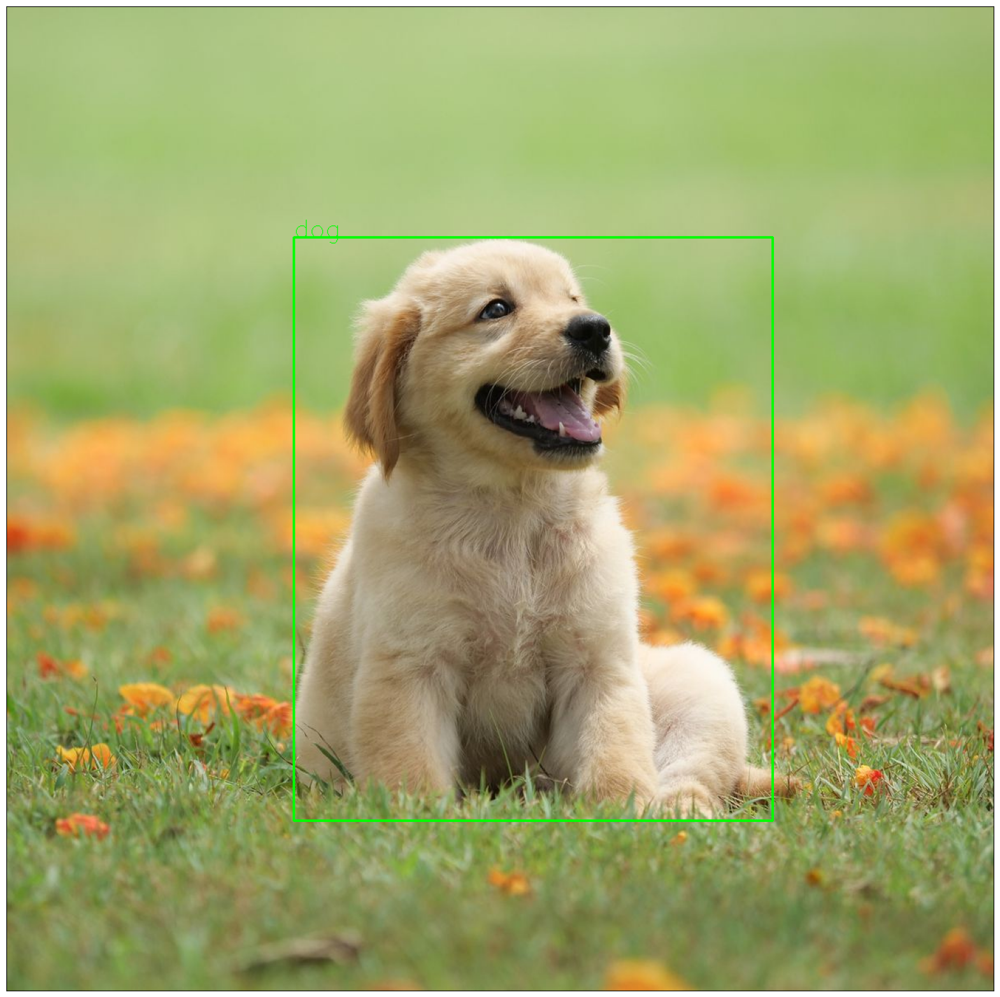

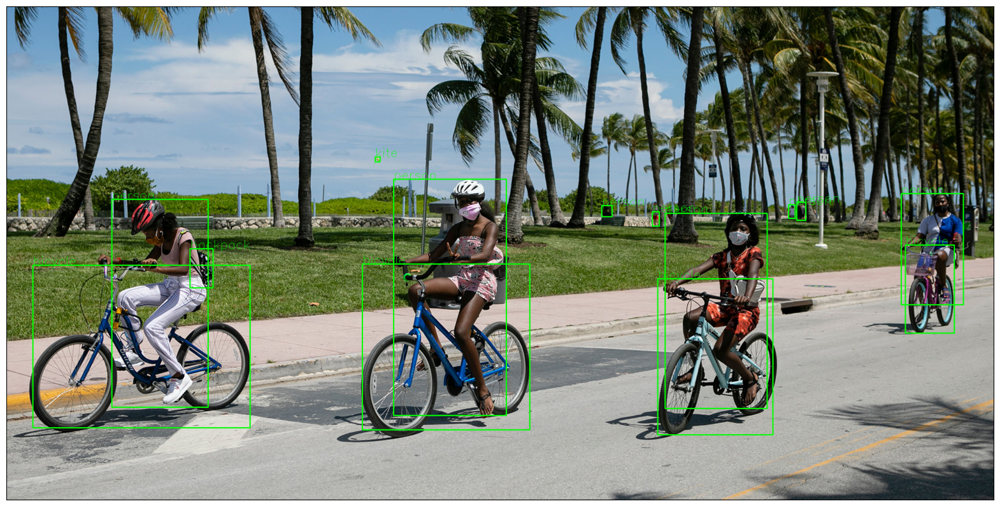

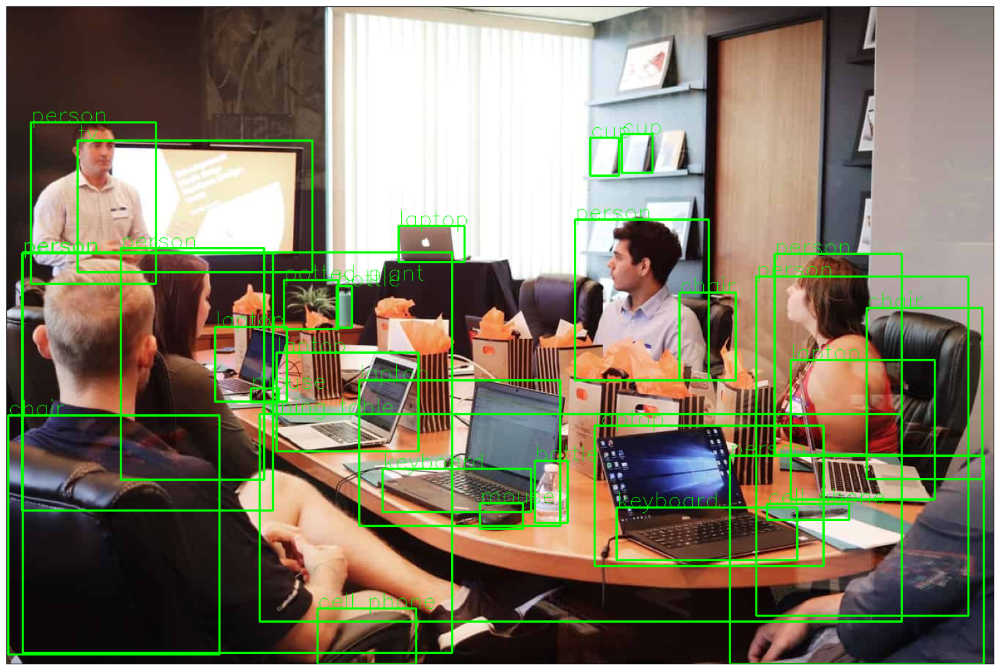

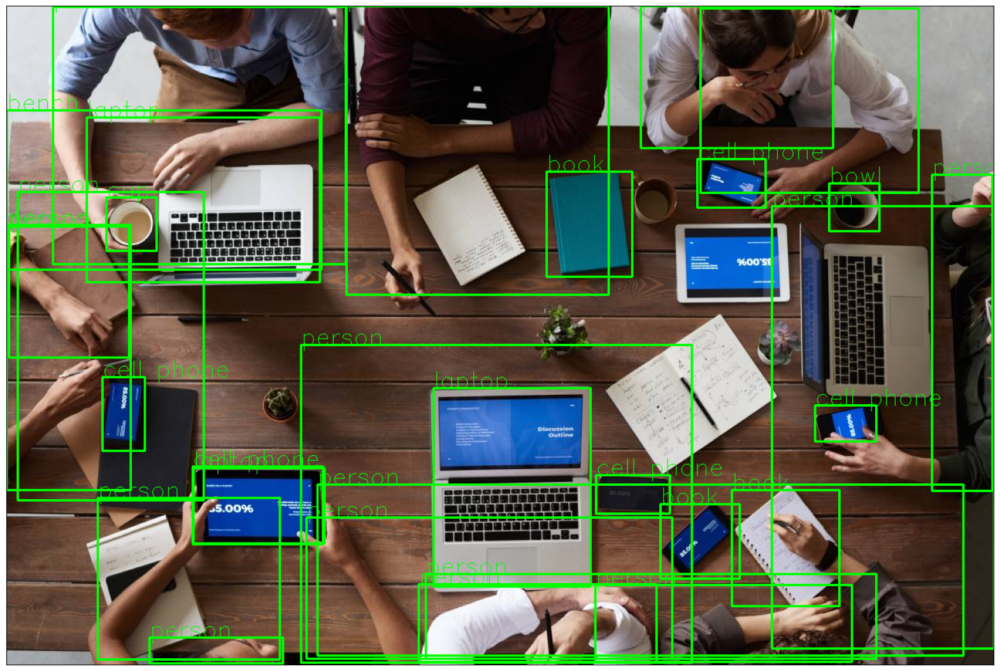

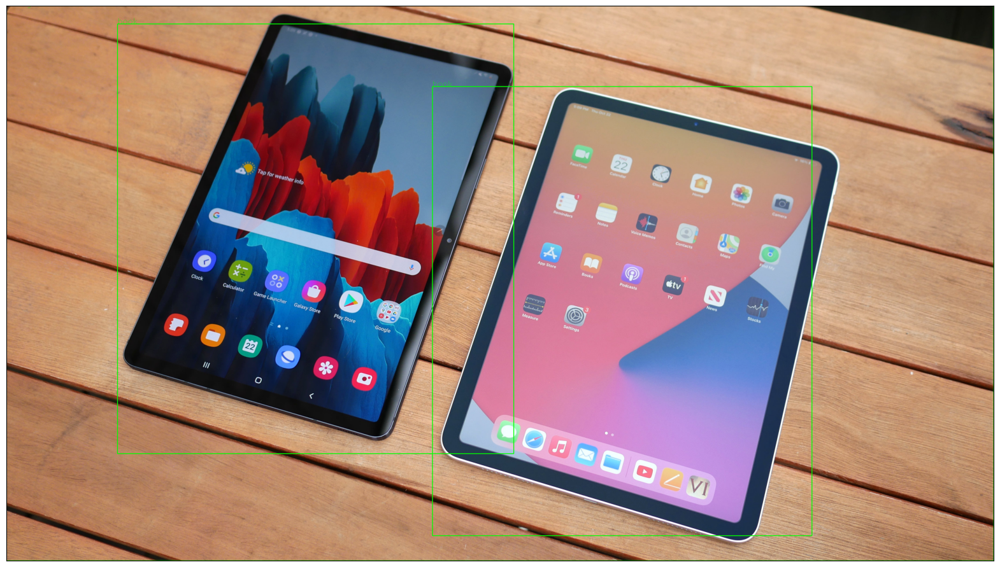

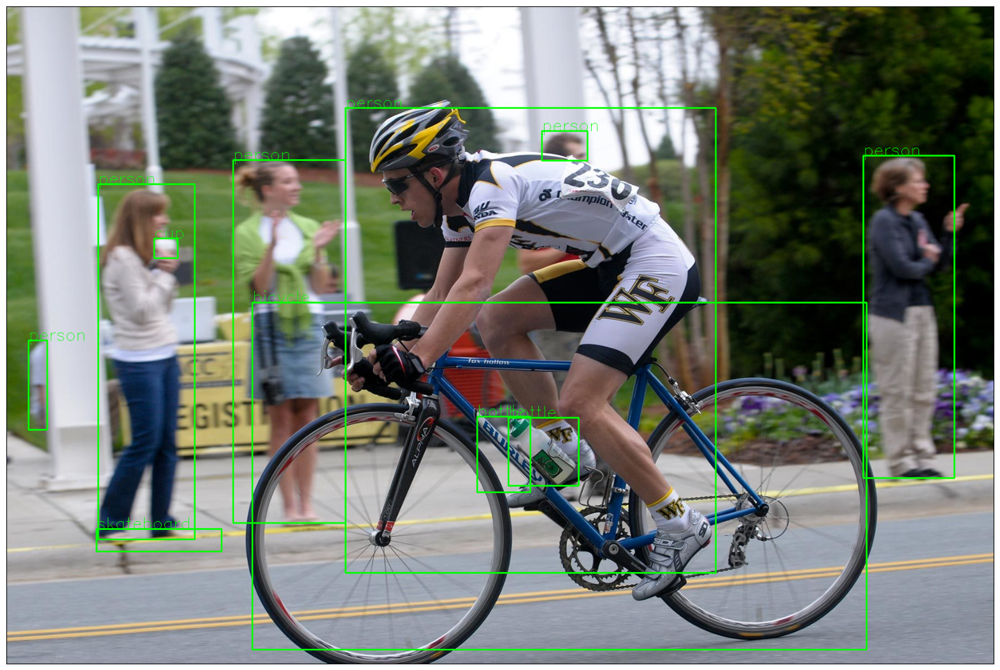

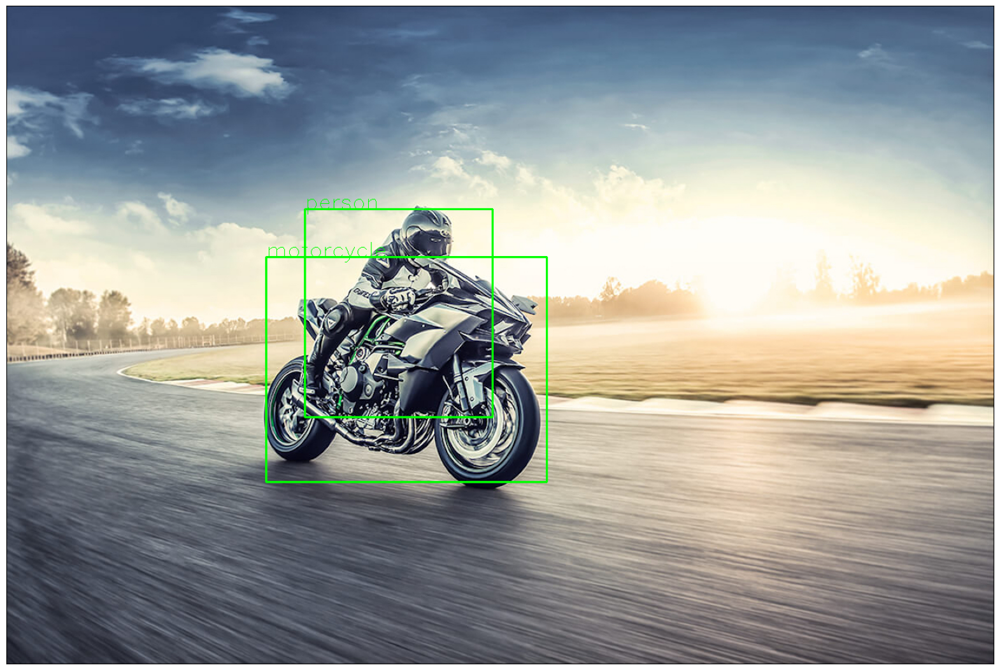

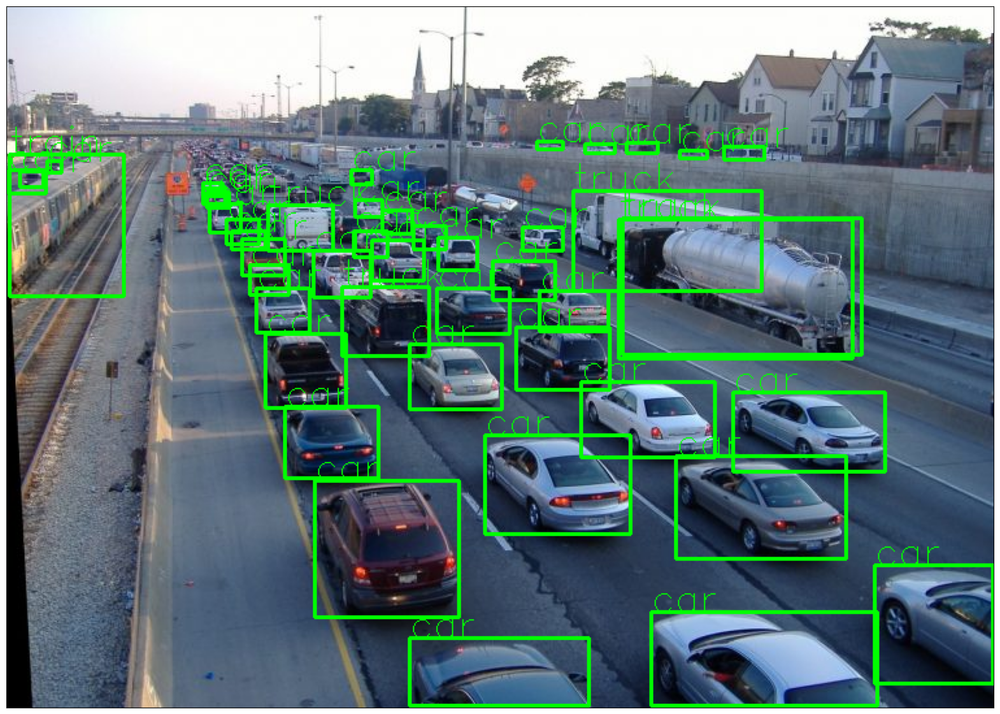

FileNotFoundError: ignored

In [ ]:
detect_object_function('content/10.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/12.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/13.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/11.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/3.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/5.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/6.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/7.jpg', rect_th=2, text_th=1, text_size=1)
detect_object_function('content/8.jpg', rect_th=2, text_th=1, text_size=1)

In [7]:

import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
from tensorflow.keras.preprocessing.image import load_img, img_to_array


def object_processing(image_path):
  # Load the pre-trained VGG16 model
  model = VGG16(weights='imagenet')
 
  picture = load_img(image_path, target_size=(224, 224))  # VGG16 requires input images of size (224, 224)
  picture = img_to_array(picture)  # Convert the image to a NumPy array
  picture = preprocess_input(picture)  # Preprocess the image according to VGG16 requirements
  picture = tf.expand_dims(picture, axis=0)  # Add a batch dimension

  # Run inference on the image
  predictions = model.predict(picture)
  decoded_predictions = decode_predictions(predictions, top=3)  # Decode the predicted probabilities into class labels

  # Display the input image
  plt.imshow(np.uint8(img_to_array(load_img(image_path))))
  plt.axis('off')
  plt.title('Input Image')
  plt.show()


  # Display the predicted class labels and probabilities
  for i, (class_id, class_name, prob) in enumerate(decoded_predictions[0]):
      print(f'Top {i+1} Prediction: {class_name} (Probability: {prob:.2%})')

1/1 [==============================] - 1s 740ms/step


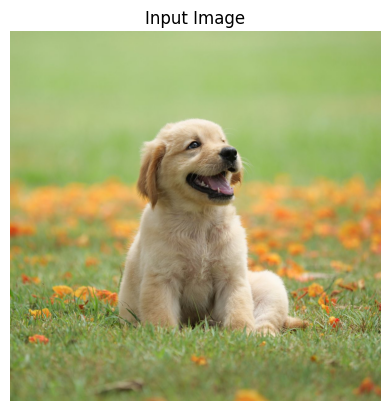

Top 1 Prediction: miniature_poodle (Probability: 39.80%)
Top 2 Prediction: standard_poodle (Probability: 37.74%)
Top 3 Prediction: toy_poodle (Probability: 9.29%)
1/1 [==============================] - 1s 764ms/step


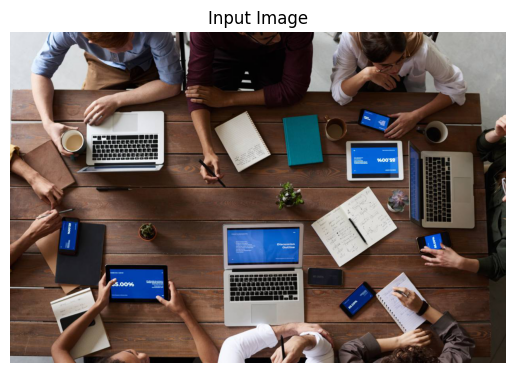

Top 1 Prediction: pay-phone (Probability: 28.93%)
Top 2 Prediction: cash_machine (Probability: 4.59%)
Top 3 Prediction: laptop (Probability: 2.83%)
1/1 [==============================] - 1s 1s/step


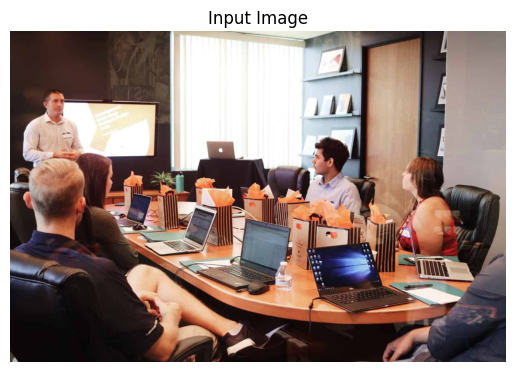

Top 1 Prediction: restaurant (Probability: 13.41%)
Top 2 Prediction: laptop (Probability: 7.01%)
Top 3 Prediction: library (Probability: 5.68%)
1/1 [==============================] - 3s 3s/step


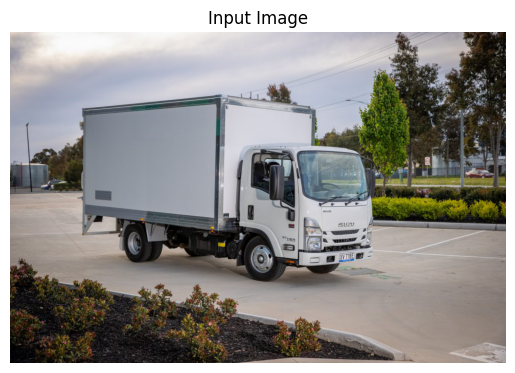

Top 1 Prediction: garbage_truck (Probability: 52.56%)
Top 2 Prediction: moving_van (Probability: 26.16%)
Top 3 Prediction: trailer_truck (Probability: 20.47%)
1/1 [==============================] - 1s 757ms/step


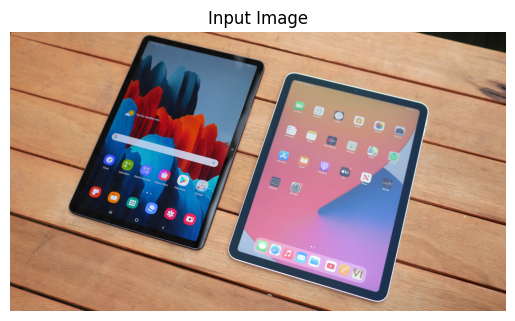

Top 1 Prediction: laptop (Probability: 32.40%)
Top 2 Prediction: digital_clock (Probability: 6.64%)
Top 3 Prediction: iPod (Probability: 5.41%)
1/1 [==============================] - 1s 1s/step


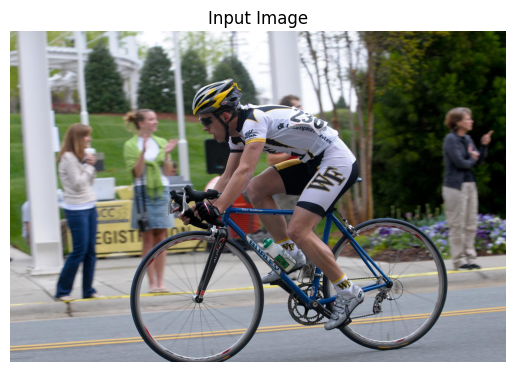

Top 1 Prediction: mountain_bike (Probability: 60.16%)
Top 2 Prediction: bicycle-built-for-two (Probability: 32.39%)
Top 3 Prediction: alp (Probability: 4.63%)
1/1 [==============================] - 1s 736ms/step


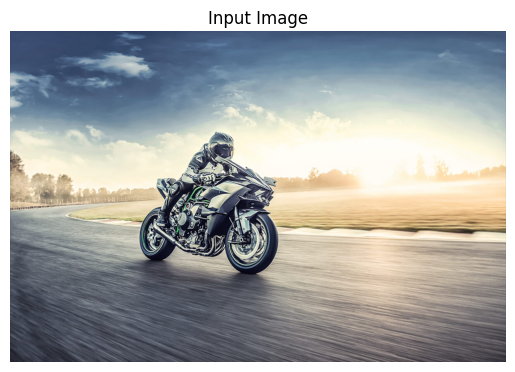

Top 1 Prediction: mountain_bike (Probability: 41.80%)
Top 2 Prediction: unicycle (Probability: 32.15%)
Top 3 Prediction: crash_helmet (Probability: 6.03%)
1/1 [==============================] - 1s 997ms/step


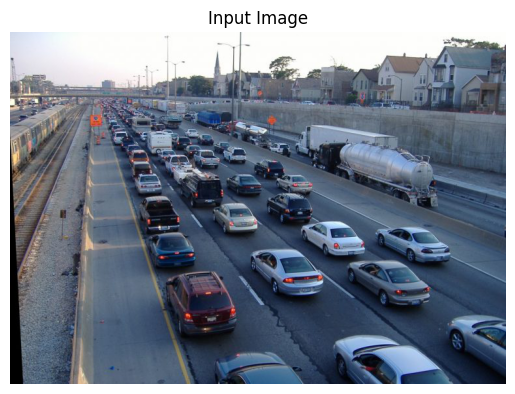

Top 1 Prediction: breakwater (Probability: 26.59%)
Top 2 Prediction: aircraft_carrier (Probability: 15.32%)
Top 3 Prediction: cab (Probability: 13.09%)
1/1 [==============================] - 1s 729ms/step


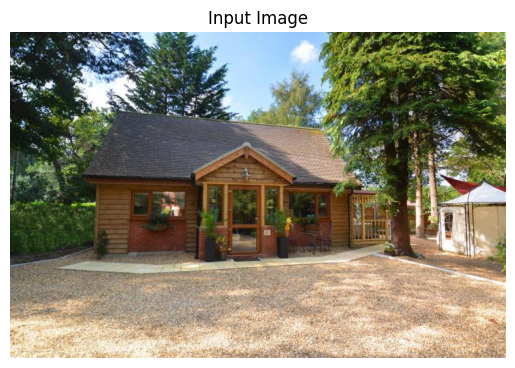

Top 1 Prediction: patio (Probability: 62.24%)
Top 2 Prediction: boathouse (Probability: 13.60%)
Top 3 Prediction: mobile_home (Probability: 5.35%)


In [9]:

object_processing('content/10.jpg')
object_processing('content/11.jpg')
object_processing('content/13.jpg')
object_processing('content/1.jpg')
object_processing('content/3.jpg')
object_processing('content/5.jpg')
object_processing('content/6.jpg')
object_processing('content/7.jpg')
object_processing('content/8.jpg')

